<h1>Table of Contents<span class="tocSkip"></span></h1>
<div class="toc"><ul class="toc-item"><li><span><a href="#Case-Study-5:-Bird-Migration" data-toc-modified-id="Case-Study-5:-Bird-Migration-1"><span class="toc-item-num">1&nbsp;&nbsp;</span>Case Study 5: Bird Migration</a></span><ul class="toc-item"><li><span><a href="#Introduction-to-GPS-Tracking-of-Birds" data-toc-modified-id="Introduction-to-GPS-Tracking-of-Birds-1.1"><span class="toc-item-num">1.1&nbsp;&nbsp;</span>Introduction to GPS Tracking of Birds</a></span></li><li><span><a href="#Simple-Data-Visualizations" data-toc-modified-id="Simple-Data-Visualizations-1.2"><span class="toc-item-num">1.2&nbsp;&nbsp;</span>Simple Data Visualizations</a></span></li><li><span><a href="#Examining-Flight-Speed" data-toc-modified-id="Examining-Flight-Speed-1.3"><span class="toc-item-num">1.3&nbsp;&nbsp;</span>Examining Flight Speed</a></span></li><li><span><a href="#Using-Datetime" data-toc-modified-id="Using-Datetime-1.4"><span class="toc-item-num">1.4&nbsp;&nbsp;</span>Using Datetime</a></span></li><li><span><a href="#Calculating-Daily-Mean-Speed" data-toc-modified-id="Calculating-Daily-Mean-Speed-1.5"><span class="toc-item-num">1.5&nbsp;&nbsp;</span>Calculating Daily Mean Speed</a></span></li><li><span><a href="#Using-the-Cartopy-Library" data-toc-modified-id="Using-the-Cartopy-Library-1.6"><span class="toc-item-num">1.6&nbsp;&nbsp;</span>Using the Cartopy Library</a></span></li></ul></li></ul></div>

## Case Study 5: Bird Migration

### Introduction to GPS Tracking of Birds

The data for this case study comes from the LifeWatch INBO project.

Several data sets have been released as part of this project.

We will use a small data set that consists of migration data for three gulls named Eric, Nico, and Sanne.

The csv file contains eight columns, and includes variables like latitude, longitude, altitude, and time stamps.

In [900]:
import pandas as pd 

birddata = pd.read_csv("bird_tracking.csv")

In [901]:
birddata.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 61920 entries, 0 to 61919
Data columns (total 9 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   Unnamed: 0          61920 non-null  int64  
 1   altitude            61920 non-null  int64  
 2   date_time           61920 non-null  object 
 3   device_info_serial  61920 non-null  int64  
 4   direction           61477 non-null  float64
 5   latitude            61920 non-null  float64
 6   longitude           61920 non-null  float64
 7   speed_2d            61477 non-null  float64
 8   bird_name           61920 non-null  object 
dtypes: float64(4), int64(3), object(2)
memory usage: 4.3+ MB


In [902]:
birddata.head()

,Unnamed: 0,altitude,date_time,device_info_serial,direction,latitude,longitude,speed_2d,bird_name
0,0,71,2013-08-15 00:18:08+00,851,-150.469753,49.419860,2.120733,0.150000,Eric
1,1,68,2013-08-15 00:48:07+00,851,-136.151141,49.419880,2.120746,2.438360,Eric
2,2,68,2013-08-15 01:17:58+00,851,160.797477,49.420310,2.120885,0.596657,Eric
3,3,73,2013-08-15 01:47:51+00,851,32.769360,49.420359,2.120859,0.310161,Eric
4,4,69,2013-08-15 02:17:42+00,851,45.191230,49.420331,2.120887,0.193132,Eric


### Simple Data Visualizations

Latitude and longitude are coordinates along the surface of a sphere, where a standard 2-D plot is a plane so we would expect very strong distortions for the flight trajectories.

This is especially true because the trajectories cover a large spatial region.

We're doing this however, primarily to have a quick way to look at the data and develop more intuition about it.

We'll be doing an actual cartographic projection later in this case study.

In [903]:
import matplotlib.pyplot as plt 
import numpy as np 


Let's extract the indices, the rows of the data frame for Eric.

Next we'll extract x and y-coordinates of the flight trajectories.

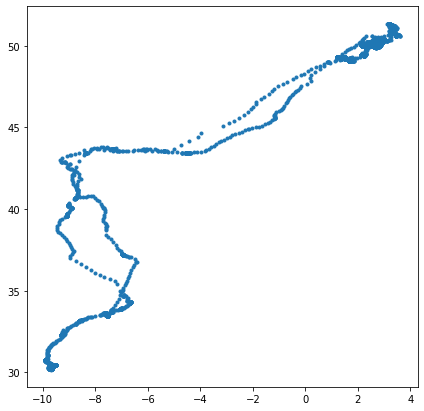

In [904]:
ix = birddata.bird_name == "Eric"
x,y = birddata.longitude[ix], birddata.latitude[ix]
plt.figure(figsize=(7,7))
plt.plot(x,y,".");

Let's then plot the trajectories for all three birds in a single plot.

We'll be extracting the bird names using pandas unique function.

In [905]:
bird_names = pd.unique(birddata.bird_name)

In [906]:
bird_names

array(['Eric', 'Nico', 'Sanne'], dtype=object)

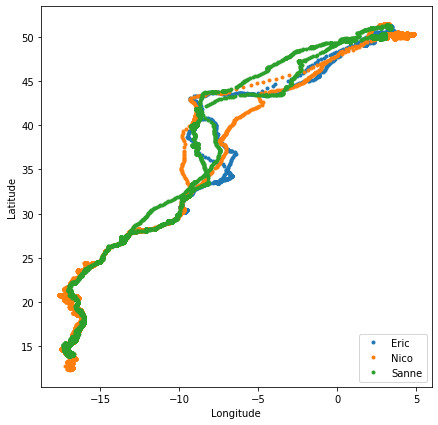

In [907]:
bird_name = pd.unique(birddata.bird_name)
plt.figure(figsize=(7,7))
for bird_name in bird_names:
    ix = birddata.bird_name == bird_name
    x,y = birddata.longitude[ix], birddata.latitude[ix]
    plt.plot(x,y,".",label=bird_name);

plt.xlabel("Longitude");
plt.ylabel("Latitude");
plt.legend(loc="lower right");
plt.savefig("3trj.pdf");

Looking at the plot, we see that all three birds seem to have pretty similar overall flight patterns.

However, Nico and Sanne seem to venture out further south than Eric does.

Which pandas function extracts all the unique values in a pd.Series?

Ans -> pd.unique

### Examining Flight Speed



(array([1.7732e+04, 1.5020e+03, 3.6900e+02, 7.8000e+01, 1.2000e+01,
        7.0000e+00, 3.0000e+00, 2.0000e+00, 3.0000e+00, 2.0000e+00]),
 array([ 0.        ,  6.34880658, 12.69761316, 19.04641974, 25.39522632,
        31.7440329 , 38.09283948, 44.44164607, 50.79045265, 57.13925923,
        63.48806581]),
 <BarContainer object of 10 artists>)

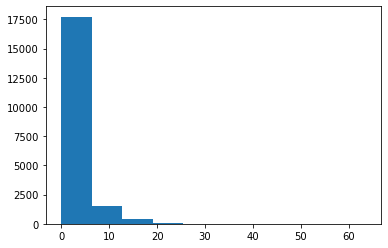

In [908]:
ix = birddata.bird_name == "Eric"
speed = birddata.speed_2d[ix]
plt.hist(speed)

At this point you should see a fairly cryptic error message.

That's try to debug this.

Let's first look at the contents of speed.

I'm just going to look at the first 10 entries.

These are numbers so so far everything looks good.

If I try to pull out a histogram using just the first ten observations of speed, everything should work out.

In [909]:
speed[:10]

0    0.150000
1    2.438360
2    0.596657
3    0.310161
4    0.193132
5    2.904772
6    3.080584
7    2.199659
8    2.640076
9    4.592211
Name: speed_2d, dtype: float64

(array([3., 1., 0., 0., 1., 2., 2., 0., 0., 1.]),
 array([0.15      , 0.59422108, 1.03844216, 1.48266324, 1.92688432,
        2.3711054 , 2.81532648, 3.25954756, 3.70376864, 4.14798972,
        4.5922108 ]),
 <BarContainer object of 10 artists>)

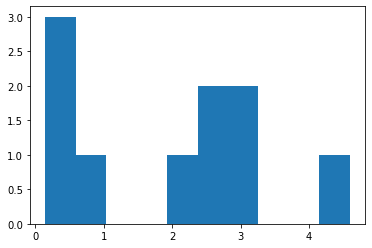

In [910]:
plt.hist(speed[:10])

Let's see if we have something else than numbers in the array.

I'm first going to look for non-number objects.

In [911]:
np.isnan(speed)

0        False
1        False
2        False
3        False
4        False
         ...  
19790    False
19791    False
19792    False
19793    False
19794    False
Name: speed_2d, Length: 19795, dtype: bool

A more elegant way to find out if we have any NaNs in our array is the following.

We can take the previous line of code and use the any method to ask if any of the output is equal to true.

In [912]:
np.isnan(speed).any()

True

The answer is true, therefore we know that there must be at least one NaN in our array.

Let's then find out how many NaNs we exactly have in our speed array.

The NumPy isnan function returns an array that consists of true and false, in other words Boolean variables, Boolean objects.

We can sum over them.

And when we do the sum, a true gets interpreted as a 1 and a false gets interpreted as 0.

In [913]:
np.sum(np.isnan(speed))

85

In this case we have 85 entries for Eric alone that are not numeric.

This is what's causing the problem with our histogram.

Let's now include only those points those observations that are actually numeric.

I'm first going to find the NaNs in my speed array.

I will assign the output to ind for index.

We can look at it to confirm that it's a Boolean vector.

We can then take a bitwise complement of the ind array which turns each occurrence of true to a false and vice versa.

In [914]:
ind = np.isnan(speed)

In [915]:
ind

0        False
1        False
2        False
3        False
4        False
         ...  
19790    False
19791    False
19792    False
19793    False
19794    False
Name: speed_2d, Length: 19795, dtype: bool

In [916]:
~ind

0        True
1        True
2        True
3        True
4        True
         ... 
19790    True
19791    True
19792    True
19793    True
19794    True
Name: speed_2d, Length: 19795, dtype: bool

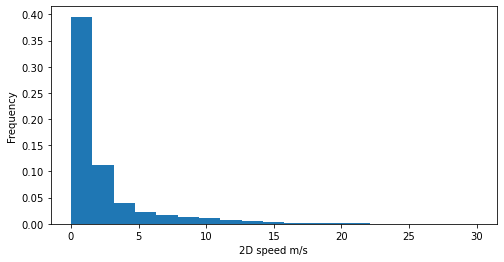

In [917]:
plt.figure(figsize=(8,4))
speed = birddata.speed_2d[birddata.bird_name == "Eric"]
ind = np.isnan(speed)
plt.hist(speed[~ind], bins=np.linspace(0,30,20), density=True);
plt.xlabel("2D speed m/s")
plt.ylabel("Frequency")
plt.savefig("hist.pdf")

Pandas provide some plotting functions as well, although less customizable than PLT plots, they readily deal with things like NaNs.

However you want to make sure that you always examine your data carefully and look for the presence of NaNs before preparing your plots.

Let's look at how we would make the histogram using pandas.

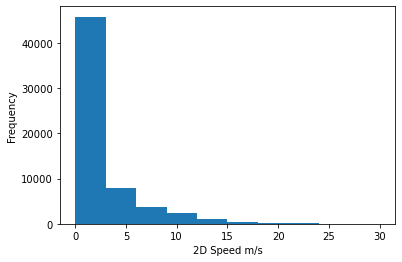

In [918]:
# plotting using pandas

birddata.speed_2d.plot(kind='hist', range=(0,30))
plt.xlabel("2D Speed m/s")
plt.savefig("pd_hist.pdf")

And we get an essentially identical histogram to what we had before.

The benefit of using pandas in this case was that we did not have to deal with NaNs explicitly.

Instead, all of that happens under the hood.


Which numpy method returns True for values that are not numericals?

Ans -> np.isnan

### Using Datetime

We often need to be able to deal with data that has timestamped events, like our GPS data in this case study.

We also frequently need to be able to do our arithmetical operations with date and timestamps, such as computing the time interval between two observations.

Python's datetime is made for dealing with these types of data.

One of the columns in our bird data set is timestamp.

It's called date time.

In [919]:
birddata.columns

Index(['Unnamed: 0', 'altitude', 'date_time', 'device_info_serial',
       'direction', 'latitude', 'longitude', 'speed_2d', 'bird_name'],
      dtype='object')

In [920]:
birddata.date_time[0:3]

0    2013-08-15 00:18:08+00
1    2013-08-15 00:48:07+00
2    2013-08-15 01:17:58+00
Name: date_time, dtype: object

The entries in the data frame are all strings for date stamps.

If we'd like to operate on the time and date stamps, such as finding out how much time has elapsed between any two timestamps, we first need to convert them into so-called daytime object, that supports our arithmetic operations.

Let's import the date time module first and explore it.

In [921]:
import datetime

In [922]:
datetime.datetime.today()

datetime.datetime(2021, 5, 15, 22, 21, 19, 860770)

In [923]:
time_1 = datetime.datetime.today()

In [924]:
time_2 = datetime.datetime.today()

In [925]:
time_2 - time_1

datetime.timedelta(microseconds=416761)

In [926]:
time_2 = datetime.datetime.today()
time_2 - time_1

datetime.timedelta(microseconds=806539)

Let's investigate the first timestamp in a bit more detail.

Here is the field following second is UTC, which stands for coordinated universal time, which is an offset that is expressed in hours.

In this case those entries are always 0, something you can check easily.

Since the offsets are all 0, we're going to ignore them moving forward.

In this case, we're interested in date string, with the exception of the last three characters.

So doing the slicing gives us access to part of the string that we actually care about.

In [927]:
date_str =birddata.date_time[0]

In [928]:
type(date_str)

str

In [929]:
date_str[:-3]

'2013-08-15 00:18:08'

Next we're going to use strip time function to turn a string to a datetime object.

In [930]:
datetime.datetime.strptime(date_str[:-3], "%Y-%m-%d %H:%M:%S")

datetime.datetime(2013, 8, 15, 0, 18, 8)

We can now use this function to go over every single row in our data set, and create a new datetime object corresponding to every single row.

In [931]:
timestamps = []
for k in range(len(birddata)):
    timestamps.append(datetime.datetime.strptime(birddata.date_time.iloc[k][:-3], "%Y-%m-%d %H:%M:%S"))

In [932]:
timestamps[0:3]

[datetime.datetime(2013, 8, 15, 0, 18, 8),
 datetime.datetime(2013, 8, 15, 0, 48, 7),
 datetime.datetime(2013, 8, 15, 1, 17, 58)]

The next step for me is to construct a panda series object and insert the timestamp from my Python list into that object.

I can then append the panda series as a new column in my bird data data frame.

In [933]:
birddata["timestamp"] = pd.Series(timestamps, index=birddata.index)

In [934]:
birddata

,Unnamed: 0,altitude,date_time,device_info_serial,direction,latitude,longitude,speed_2d,bird_name,timestamp
0,0,71,2013-08-15 00:18:08+00,851,-150.469753,49.419860,2.120733,0.150000,Eric,2013-08-15 00:18:08
1,1,68,2013-08-15 00:48:07+00,851,-136.151141,49.419880,2.120746,2.438360,Eric,2013-08-15 00:48:07
2,2,68,2013-08-15 01:17:58+00,851,160.797477,49.420310,2.120885,0.596657,Eric,2013-08-15 01:17:58
3,3,73,2013-08-15 01:47:51+00,851,32.769360,49.420359,2.120859,0.310161,Eric,2013-08-15 01:47:51
4,4,69,2013-08-15 02:17:42+00,851,45.191230,49.420331,2.120887,0.193132,Eric,2013-08-15 02:17:42
...,...,...,...,...,...,...,...,...,...,...
61915,61915,11,2014-04-30 22:00:08+00,833,45.448157,51.352572,3.177151,0.208087,Sanne,2014-04-30 22:00:08
61916,61916,6,2014-04-30 22:29:57+00,833,-112.073055,51.352585,3.177144,1.522662,Sanne,2014-04-30 22:29:57
61917,61917,5,2014-04-30 22:59:52+00,833,69.989037,51.352622,3.177257,3.120545,Sanne,2014-04-30 22:59:52
61918,61918,16,2014-04-30 23:29:43+00,833,88.376373,51.354641,3.181509,0.592115,Sanne,2014-04-30 23:29:43


What I'd like to do next is to create a list that captures the amount of time that has elapsed since the beginning of data collection.

In [935]:
times = birddata.timestamp[birddata.bird_name == "Eric"]
elapsed_time = [time - times[0] for time in times]

In [936]:
elapsed_time[0]

Timedelta('0 days 00:00:00')

In [937]:
elapsed_time[1000]

Timedelta('12 days 02:02:00')

But how can we measure time in certain units, like hours or days?

We can take the object that we had before, and we can simply divide that by a time delta object.

In [938]:
elapsed_time[1000] / datetime.timedelta(days=1)

12.084722222222222

In [939]:
elapsed_time[1000] / datetime.timedelta(hours=1)

290.03333333333336

We can now look at the data for Eric in a little bit more detail.

I'm going to make a plot where on the x-axis, we have the number of the observation, and on the y-axis we have the amount of time that has elapsed, measured in days.

In [940]:
birddata

,Unnamed: 0,altitude,date_time,device_info_serial,direction,latitude,longitude,speed_2d,bird_name,timestamp
0,0,71,2013-08-15 00:18:08+00,851,-150.469753,49.419860,2.120733,0.150000,Eric,2013-08-15 00:18:08
1,1,68,2013-08-15 00:48:07+00,851,-136.151141,49.419880,2.120746,2.438360,Eric,2013-08-15 00:48:07
2,2,68,2013-08-15 01:17:58+00,851,160.797477,49.420310,2.120885,0.596657,Eric,2013-08-15 01:17:58
3,3,73,2013-08-15 01:47:51+00,851,32.769360,49.420359,2.120859,0.310161,Eric,2013-08-15 01:47:51
4,4,69,2013-08-15 02:17:42+00,851,45.191230,49.420331,2.120887,0.193132,Eric,2013-08-15 02:17:42
...,...,...,...,...,...,...,...,...,...,...
61915,61915,11,2014-04-30 22:00:08+00,833,45.448157,51.352572,3.177151,0.208087,Sanne,2014-04-30 22:00:08
61916,61916,6,2014-04-30 22:29:57+00,833,-112.073055,51.352585,3.177144,1.522662,Sanne,2014-04-30 22:29:57
61917,61917,5,2014-04-30 22:59:52+00,833,69.989037,51.352622,3.177257,3.120545,Sanne,2014-04-30 22:59:52
61918,61918,16,2014-04-30 23:29:43+00,833,88.376373,51.354641,3.181509,0.592115,Sanne,2014-04-30 23:29:43


In [941]:
bd = birddata.drop("timestamp", axis=1)

In [942]:
bd

,Unnamed: 0,altitude,date_time,device_info_serial,direction,latitude,longitude,speed_2d,bird_name
0,0,71,2013-08-15 00:18:08+00,851,-150.469753,49.419860,2.120733,0.150000,Eric
1,1,68,2013-08-15 00:48:07+00,851,-136.151141,49.419880,2.120746,2.438360,Eric
2,2,68,2013-08-15 01:17:58+00,851,160.797477,49.420310,2.120885,0.596657,Eric
3,3,73,2013-08-15 01:47:51+00,851,32.769360,49.420359,2.120859,0.310161,Eric
4,4,69,2013-08-15 02:17:42+00,851,45.191230,49.420331,2.120887,0.193132,Eric
...,...,...,...,...,...,...,...,...,...
61915,61915,11,2014-04-30 22:00:08+00,833,45.448157,51.352572,3.177151,0.208087,Sanne
61916,61916,6,2014-04-30 22:29:57+00,833,-112.073055,51.352585,3.177144,1.522662,Sanne
61917,61917,5,2014-04-30 22:59:52+00,833,69.989037,51.352622,3.177257,3.120545,Sanne
61918,61918,16,2014-04-30 23:29:43+00,833,88.376373,51.354641,3.181509,0.592115,Sanne


In [943]:
birddata

,Unnamed: 0,altitude,date_time,device_info_serial,direction,latitude,longitude,speed_2d,bird_name,timestamp
0,0,71,2013-08-15 00:18:08+00,851,-150.469753,49.419860,2.120733,0.150000,Eric,2013-08-15 00:18:08
1,1,68,2013-08-15 00:48:07+00,851,-136.151141,49.419880,2.120746,2.438360,Eric,2013-08-15 00:48:07
2,2,68,2013-08-15 01:17:58+00,851,160.797477,49.420310,2.120885,0.596657,Eric,2013-08-15 01:17:58
3,3,73,2013-08-15 01:47:51+00,851,32.769360,49.420359,2.120859,0.310161,Eric,2013-08-15 01:47:51
4,4,69,2013-08-15 02:17:42+00,851,45.191230,49.420331,2.120887,0.193132,Eric,2013-08-15 02:17:42
...,...,...,...,...,...,...,...,...,...,...
61915,61915,11,2014-04-30 22:00:08+00,833,45.448157,51.352572,3.177151,0.208087,Sanne,2014-04-30 22:00:08
61916,61916,6,2014-04-30 22:29:57+00,833,-112.073055,51.352585,3.177144,1.522662,Sanne,2014-04-30 22:29:57
61917,61917,5,2014-04-30 22:59:52+00,833,69.989037,51.352622,3.177257,3.120545,Sanne,2014-04-30 22:59:52
61918,61918,16,2014-04-30 23:29:43+00,833,88.376373,51.354641,3.181509,0.592115,Sanne,2014-04-30 23:29:43


In [944]:
birddata.drop("timestamp",inplace=True, axis=1)

In [945]:
birddata

,Unnamed: 0,altitude,date_time,device_info_serial,direction,latitude,longitude,speed_2d,bird_name
0,0,71,2013-08-15 00:18:08+00,851,-150.469753,49.419860,2.120733,0.150000,Eric
1,1,68,2013-08-15 00:48:07+00,851,-136.151141,49.419880,2.120746,2.438360,Eric
2,2,68,2013-08-15 01:17:58+00,851,160.797477,49.420310,2.120885,0.596657,Eric
3,3,73,2013-08-15 01:47:51+00,851,32.769360,49.420359,2.120859,0.310161,Eric
4,4,69,2013-08-15 02:17:42+00,851,45.191230,49.420331,2.120887,0.193132,Eric
...,...,...,...,...,...,...,...,...,...
61915,61915,11,2014-04-30 22:00:08+00,833,45.448157,51.352572,3.177151,0.208087,Sanne
61916,61916,6,2014-04-30 22:29:57+00,833,-112.073055,51.352585,3.177144,1.522662,Sanne
61917,61917,5,2014-04-30 22:59:52+00,833,69.989037,51.352622,3.177257,3.120545,Sanne
61918,61918,16,2014-04-30 23:29:43+00,833,88.376373,51.354641,3.181509,0.592115,Sanne


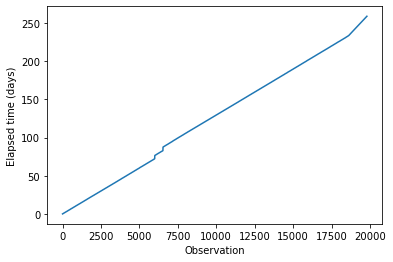

In [946]:
timestamps = []
for k in range(len(birddata)):
    timestamps.append(datetime.datetime.strptime(birddata.date_time.iloc[k][:-3], "%Y-%m-%d %H:%M:%S"))

birddata["timestamp"] = pd.Series(timestamps, index=birddata.index)

times = birddata.timestamp[birddata.bird_name == "Eric"]
elapsed_time = [time - times[0] for time in times]
elapsed_days = np.array(elapsed_time) / datetime.timedelta(days=1)

plt.plot(elapsed_days)
plt.xlabel("Observation")
plt.ylabel("Elapsed time (days)")
plt.savefig("timeplot.pdf")

In [947]:
elapsed_days

array([0.0, 0.02082175925925926, 0.04155092592592593, ...,
       258.9399652777778, 258.9607175925926, 258.9814930555556],
      dtype=object)

In [948]:
len(elapsed_days)

19795

If the times that passes between any two consecutive observations was the exact same, for all observations, we would see one perfectly straight line.

In this case we see a couple of jumps in our curve.

What this indicates to us is that there are observations that are further apart from one another than other observations in the data set.

This type of exploration of data really helps you understand your data set very thoroughly.

What does datetime.datetime.strptime do?

Ans -> Takes in a date and time string, as well as an expected format string, and returns a formatted datetime object.

How can you find the difference in time between two datetime objects time_1 and time_2?

Ans -> time_2 - time_1

### Calculating Daily Mean Speed

Our next goal is to create a plot where on the y-axis, we have the mean daily speed.

And on the x-axis, we have time measured in days.

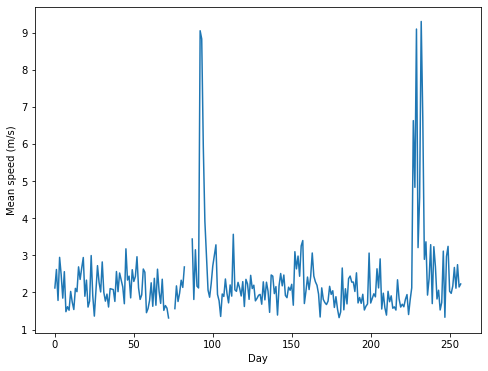

In [949]:
timestamps = []
for k in range(len(birddata)):
    timestamps.append(datetime.datetime.strptime(birddata.date_time.iloc[k][:-3], "%Y-%m-%d %H:%M:%S"))

birddata["timestamp"] = pd.Series(timestamps, index=birddata.index)

times = birddata.timestamp[birddata.bird_name == "Eric"]
elapsed_time = [time - times[0] for time in times]
elapsed_days = np.array(elapsed_time) / datetime.timedelta(days=1)

next_day = 1
inds = []
daily_mean_speed = []
for i,t in enumerate(elapsed_days):
    if t < next_day:
        inds.append(i)
    else:
        # compute mean speed
        daily_mean_speed.append(np.mean(birddata.speed_2d[inds]))
        next_day += 1
        inds = []

plt.figure(figsize=(8,6))
plt.plot(daily_mean_speed)
plt.xlabel("Day")
plt.ylabel("Mean speed (m/s)")
plt.savefig("dms.pdf")

So looking at the plot, we first see that we have data for approximately 260 days.

On any given typical, or average day, Eric is flying, on average, about 2 meters per second, just by eyeballing the figure.

However, we can see that there seemed to be two periods within the observation window during which Eric is flying substantially more.

These are the periods that correspond to his migration patterns.

```text
![daily_mean_speed.png](figures/daily_mean_speed.png)

The displayed mean speed is for Eric
```

![daily_mean_speed.png](figures/daily_mean_speed.png)

We can see that around day, equal to 90 or 95 perhaps, his mean daily speed is as high as 9 meters per second.

We see a similar peak for day perhaps 230 or so.

Looking at this plot, we've been able to identify when exactly Eric carries out his migration.

The next step we'd like to accomplish is to find out where he actually migrates from and where does he end up.


In [950]:
times = birddata.timestamp[birddata.bird_name == "Sanne"]

In [951]:
times

40916   2013-08-15 00:01:08
40917   2013-08-15 00:31:00
40918   2013-08-15 01:01:19
40919   2013-08-15 01:31:38
40920   2013-08-15 02:01:24
                ...        
61915   2014-04-30 22:00:08
61916   2014-04-30 22:29:57
61917   2014-04-30 22:59:52
61918   2014-04-30 23:29:43
61919   2014-04-30 23:59:34
Name: timestamp, Length: 21004, dtype: datetime64[ns]

In [952]:
type(times)

pandas.core.series.Series

In [953]:
birddata

,Unnamed: 0,altitude,date_time,device_info_serial,direction,latitude,longitude,speed_2d,bird_name,timestamp
0,0,71,2013-08-15 00:18:08+00,851,-150.469753,49.419860,2.120733,0.150000,Eric,2013-08-15 00:18:08
1,1,68,2013-08-15 00:48:07+00,851,-136.151141,49.419880,2.120746,2.438360,Eric,2013-08-15 00:48:07
2,2,68,2013-08-15 01:17:58+00,851,160.797477,49.420310,2.120885,0.596657,Eric,2013-08-15 01:17:58
3,3,73,2013-08-15 01:47:51+00,851,32.769360,49.420359,2.120859,0.310161,Eric,2013-08-15 01:47:51
4,4,69,2013-08-15 02:17:42+00,851,45.191230,49.420331,2.120887,0.193132,Eric,2013-08-15 02:17:42
...,...,...,...,...,...,...,...,...,...,...
61915,61915,11,2014-04-30 22:00:08+00,833,45.448157,51.352572,3.177151,0.208087,Sanne,2014-04-30 22:00:08
61916,61916,6,2014-04-30 22:29:57+00,833,-112.073055,51.352585,3.177144,1.522662,Sanne,2014-04-30 22:29:57
61917,61917,5,2014-04-30 22:59:52+00,833,69.989037,51.352622,3.177257,3.120545,Sanne,2014-04-30 22:59:52
61918,61918,16,2014-04-30 23:29:43+00,833,88.376373,51.354641,3.181509,0.592115,Sanne,2014-04-30 23:29:43


In [955]:
times[0]

KeyError: 0

In [956]:
times[40916]

Timestamp('2013-08-15 00:01:08')

In [957]:
times[:1]

40916   2013-08-15 00:01:08
Name: timestamp, dtype: datetime64[ns]

In [958]:
times[:1]

40916   2013-08-15 00:01:08
Name: timestamp, dtype: datetime64[ns]

In [959]:
firstTimestamp = times[:1]

In [960]:
firstTimestamp

40916   2013-08-15 00:01:08
Name: timestamp, dtype: datetime64[ns]

### Using the Cartopy Library

Our next step is to install Cartopy, a library that provides cartographic tools for Python.

Cartopy makes it easy to draw maps, and it seems to work well on multiple platforms.

We should point out that there is some other libraries for working with maps, but some of them don't work on both Mac and Windows platforms, and others can be more difficult to use.

To move forward, we need to specify a specific projection that we're interested in using.

Cartopy provides several different projection alternatives.

In this case, we'll be using one of the standard projections.

The final line, the plot line, is what introduces the transformation.

In this case, we're using a specific transformation from CCRS.

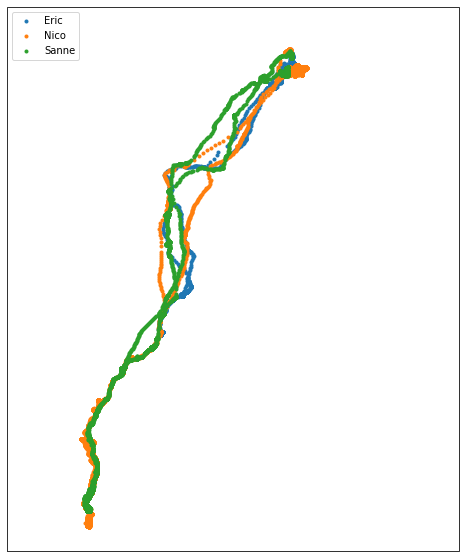

In [961]:
import cartopy.crs as ccrs
import cartopy.feature as cfeature

proj = ccrs.Mercator()

plt.figure(figsize=(10,10))
ax = plt.axes(projection=proj)
ax.set_extent((-25.0,20.0,52.0,10.0))

for name in bird_names:
    ix = birddata["bird_name"] == name
    x,y = birddata.longitude[ix], birddata.latitude[ix]
    ax.plot(x, y, '.', transform=ccrs.Geodetic(), label=name)

plt.legend(loc="upper left")
plt.savefig("map.pdf")

In fact, we can superimpose a map on top of this.

We can add some more features to our plot.

For example, we can add land, borders of countries, and so on.

In this case, I'm adding four different lines.

These four lines add landmasses, oceans, coastlines, and borders of countries to the map.

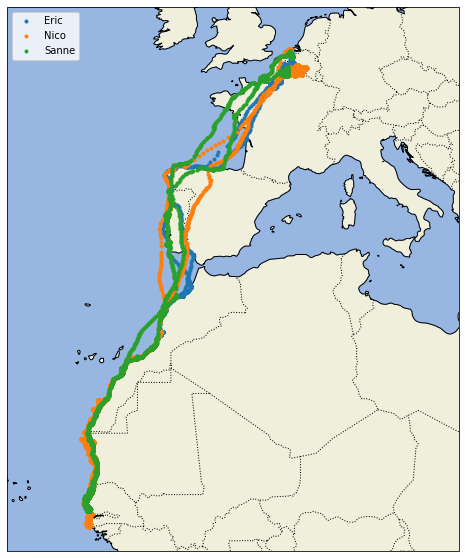

In [962]:
import cartopy.crs as ccrs
import cartopy.feature as cfeature

proj = ccrs.Mercator()

plt.figure(figsize=(10,10))
ax = plt.axes(projection=proj)
ax.set_extent((-25.0,20.0,52.0,10.0))
ax.add_feature(cfeature.LAND)
ax.add_feature(cfeature.OCEAN)
ax.add_feature(cfeature.COASTLINE)
ax.add_feature(cfeature.BORDERS, linestyle=":")

for name in bird_names:
    ix = birddata["bird_name"] == name
    x,y = birddata.longitude[ix], birddata.latitude[ix]
    ax.plot(x, y, '.', transform=ccrs.Geodetic(), label=name)

plt.legend(loc="upper left")
plt.savefig("map.pdf")